In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

c:\Users\richa\AppData\Local\Programs\Python\Python310\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.17.3 and <1.25.0 is required for this version of SciPy (detected version 1.26.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Q1

In [3]:
# make a mdp to generate episodes, assume transition prob is reward prob
class TheMDP:
    def __init__(self, n_states, n_actions, n_rewards):
        self.n_states = n_states
        self.n_actions = n_actions
        self.n_rewards = n_rewards
        
    def generate_episode(self, policy):
        episode = []
        # 4 total states, 2 actions, 2 rewards
        # states 0 and 3 are terminal states
        # every state except 0 and 3 has 2 actions, left and right
        # every state except 0 and 3 has 2 rewards, 0 and 1
        possible_start_states = [1, 2]
        state = np.random.choice(possible_start_states)
        while state != 0 and state != 3:
            action = np.random.choice(self.n_actions, p=policy[state])
            reward = n_rewards[action]
            episode.append((state, action, reward))
            state = state + 1 if action == 1 else state - 1
        return episode
    
# define n_states, n_actions, n_rewards, transition_prob, policy, start_state
n_states = 4
n_actions = [0, 1]
n_rewards = [-1, 1]
policy = np.array([[0.5, 0.5], [0.5, 0.5], [0.5, 0.5], [0.5, 0.5]])

In [4]:
# generate 10000 episodes, first visit monte carlo
gamma = 1
the_mdp = TheMDP(n_states, n_actions, n_rewards)
# returns is a  2d array which stores the returns for each state and each action
returns = np.zeros((n_states, len(n_actions)))
count = np.zeros((n_states, len(n_actions)))
visited = np.zeros((n_states, len(n_actions)))
q = np.zeros((n_states, len(n_actions)))
for i in range(10000):
    episode = the_mdp.generate_episode(policy)
    G = 0
    for j in range(len(episode)-1, -1, -1):
        G = episode[j][2] + gamma * G
        # if the state, action are not in the episode before, add the return to the returns array
        if visited[episode[j][0], episode[j][1]] == 0:
            returns[episode[j][0], episode[j][1]] += G
            count[episode[j][0], episode[j][1]] += 1
            visited[episode[j][0], episode[j][1]] = 1
            q[episode[j][0], episode[j][1]] = returns[episode[j][0], episode[j][1]] / count[episode[j][0], episode[j][1]]
            # find optimal policy for each state given this episode
            policy[episode[j][0], np.argmax(q[episode[j][0]])] = 1
            policy[episode[j][0], np.argmin(q[episode[j][0]])] = 0
print('The optimal policy is: ')
print(policy)
print('The optimal q is: ')
print(q)

The optimal policy is: 
[[0.5 0.5]
 [0.  1. ]
 [0.  1. ]
 [0.5 0.5]]
The optimal q is: 
[[0. 0.]
 [0. 2.]
 [0. 1.]
 [0. 0.]]


Q4

In [5]:
import gym



In [6]:
env = gym.make('Blackjack-v1', sab = True)
games = 10000
gamma = 1

In [7]:
# env.action_space
x = env.reset()
print(x)
print(x[0][2])
a = env.step(1)
print(a)

((12, 10, False), {})
False
((16, 10, False), 0.0, False, False, {})


c:\Users\richa\AppData\Local\Programs\Python\Python310\lib\site-packages\gym\utils\passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):


In [8]:
games = 10000
game_eps = []
for i in range(games):
    eps = []
    # while episode is not over
    temp = env.reset()
    done = False
    curr_state = temp[0]
    # print("Temp is :" , temp)
    while not done:
        if temp[0][0] == 20 or temp[0][0] == 21:
            step_vals = env.step(0) # stick
            # print("Stepvals (stick) is :" , step_vals)
            action = 0
            reward = step_vals[1]
        else:
            step_vals = env.step(1) # hit
            # print("Stepvals (hit) is :" , step_vals)
            action = 1
            reward = step_vals[1]
        eps.append((curr_state, action, reward))
        new_temp = []
        for i in range(len(step_vals)):
            if i == 0 or i == 4:
                new_temp.append(step_vals[i])
        # print("New temp is :" , new_temp)
        # print(new_temp)
        # print(tuple(new_temp))
        temp = tuple(new_temp)
        done = step_vals[2] # is True if episode is over
        curr_state = temp[0]
    game_eps.append(eps)
# print("Game eps is :" , game_eps)


In [9]:
print(game_eps)

[[((14, 3, False), 1, -1.0)], [((16, 10, False), 1, 0.0), ((21, 10, False), 0, 1.0)], [((14, 10, False), 1, 0.0), ((15, 10, False), 1, -1.0)], [((18, 5, False), 1, -1.0)], [((9, 9, False), 1, 0.0), ((15, 9, False), 1, 0.0), ((19, 9, False), 1, -1.0)], [((20, 4, False), 0, 1.0)], [((7, 2, False), 1, 0.0), ((17, 2, False), 1, -1.0)], [((20, 10, False), 0, 1.0)], [((20, 1, False), 0, -1.0)], [((11, 5, False), 1, 0.0), ((15, 5, False), 1, -1.0)], [((12, 10, False), 1, 0.0), ((14, 10, False), 1, 0.0), ((16, 10, False), 1, 0.0), ((21, 10, False), 0, 1.0)], [((12, 2, False), 1, -1.0)], [((18, 10, False), 1, -1.0)], [((9, 1, False), 1, 0.0), ((15, 1, False), 1, 0.0), ((16, 1, False), 1, -1.0)], [((19, 9, False), 1, -1.0)], [((20, 10, False), 0, 1.0)], [((14, 10, False), 1, -1.0)], [((17, 3, False), 1, -1.0)], [((19, 6, False), 1, -1.0)], [((12, 10, False), 1, 0.0), ((21, 10, False), 0, 1.0)], [((15, 1, False), 1, 0.0), ((20, 1, False), 0, 0.0)], [((18, 6, True), 1, 0.0), ((20, 6, True), 0, 0.0

In [10]:
# predict value function for usable ace using every visit monte carlo, 200 states are possible
# returns_usable_ten is a dictionary which stores the return for each state, there are 200 states. The key is the state, the value is the return
returns_usable_ten = {}
# values is a dictionary which stores the value for each state, there are 200 states. The key is the state, the value is the value
values_usable_ten = {}
count_usable_ten = {}
returns_unusable_ten = {}
values_unusable_ten = {}
count_unusable_ten = {}
for ep in game_eps:
    G = 0

    for i in range(len(ep)-1, -1, -1):
        G = ep[i][2] + gamma * G
        if ep[i][0][2] == True: # usable ace
            if ep[i][0] not in returns_usable_ten:
                returns_usable_ten[ep[i][0]] = G
                count_usable_ten[ep[i][0]] = 1
            else:
                returns_usable_ten[ep[i][0]] += G
                count_usable_ten[ep[i][0]] += 1
        else:
            if ep[i][0] not in returns_unusable_ten:
                returns_unusable_ten[ep[i][0]] = G
                count_unusable_ten[ep[i][0]] = 1
            else:
                returns_unusable_ten[ep[i][0]] += G
                count_unusable_ten[ep[i][0]] += 1
for key in returns_usable_ten:
    values_usable_ten[key] = returns_usable_ten[key] / count_usable_ten[key]
for key in returns_unusable_ten:
    values_unusable_ten[key] = returns_unusable_ten[key] / count_unusable_ten[key]
    

print('The value function for usable ace is: ')
print(values_usable_ten)
print('The value function for unusable ace is: ')
print(values_unusable_ten)




The value function for usable ace is: 
{(20, 6, True): 0.8, (18, 6, True): -0.42857142857142855, (20, 10, True): 0.38961038961038963, (21, 3, True): 0.9692307692307692, (18, 2, True): -0.3333333333333333, (19, 10, True): -0.46153846153846156, (19, 4, True): -0.05263157894736842, (21, 4, True): 0.9545454545454546, (19, 8, True): -0.4090909090909091, (15, 5, True): 0.0, (14, 5, True): -0.5, (12, 5, True): -0.3333333333333333, (21, 10, True): 0.8978494623655914, (20, 7, True): 0.6666666666666666, (19, 5, True): -0.2631578947368421, (18, 5, True): -0.47368421052631576, (21, 2, True): 1.0, (18, 9, True): -0.06666666666666667, (17, 10, True): -0.6458333333333334, (18, 10, True): -0.47692307692307695, (14, 10, True): -0.3, (21, 5, True): 1.0, (16, 10, True): -0.5952380952380952, (19, 3, True): -0.5882352941176471, (14, 3, True): -0.5, (21, 1, True): 0.4772727272727273, (13, 8, True): -0.2857142857142857, (20, 8, True): 0.6666666666666666, (20, 2, True): 0.9545454545454546, (13, 2, True): 0.0,

In [11]:
games = 500000
game_eps = []
for i in range(500000):
    eps = []
    # while episode is not over
    temp = env.reset()
    done = False
    curr_state = temp[0]
    while not done:
        if temp[0][0] == 20 or temp[0][0] == 21:
            step_vals = env.step(0) # stick
            action = 0
            reward = step_vals[1]
        else:
            step_vals = env.step(1) # hit
            action = 1
            reward = step_vals[1]
        eps.append((curr_state, action, reward))
        new_temp = []
        for i in range(len(step_vals)):
            if i == 0 or i == 4:
                new_temp.append(step_vals[i])
        # print	(new_temp)
        temp = tuple(new_temp)
        done = step_vals[2] # is True if episode is over
        curr_state = temp[0]
    game_eps.append(eps)
print(game_eps)
returns_usable_five = {}
values_usable_five = {}
count_usable_five = {}
returns_unusable_five = {}
values_unusable_five = {}
count_unusable_five = {}
for ep in game_eps:
    G = 0

    for i in range(len(ep)-1, -1, -1):
        G = ep[i][2] + gamma * G
        if ep[i][0][2] == True: # usable ace
            if ep[i][0] not in returns_usable_five:
                returns_usable_five[ep[i][0]] = G
                count_usable_five[ep[i][0]] = 1
            else:
                returns_usable_five[ep[i][0]] += G
                count_usable_five[ep[i][0]] += 1
        else:
            if ep[i][0] not in returns_unusable_five:
                returns_unusable_five[ep[i][0]] = G
                count_unusable_five[ep[i][0]] = 1
            else:
                returns_unusable_five[ep[i][0]] += G
                count_unusable_five[ep[i][0]] += 1
for key in returns_usable_five:
    values_usable_five[key] = returns_usable_five[key] / count_usable_five[key]
for key in returns_unusable_five:
    values_unusable_five[key] = returns_unusable_five[key] / count_unusable_five[key]
    
print('The value function for usable ace is: ')
print(values_usable_five)
print('The value function for unusable ace is: ')
print(values_unusable_five)
num = 0
# for key in values_usable_five:
#     if key[0] == 20:
#         num+=1
#         # print(values_usable_five[key])
# print(num)	


[[((10, 10, False), 1, 0.0), ((20, 10, False), 0, -1.0)], [((7, 4, False), 1, 0.0), ((18, 4, True), 1, 0.0), ((18, 4, False), 1, -1.0)], [((20, 5, False), 0, 1.0)], [((16, 7, False), 1, -1.0)], [((20, 1, False), 0, 1.0)], [((12, 2, False), 1, 0.0), ((15, 2, False), 1, 0.0), ((16, 2, False), 1, -1.0)], [((16, 10, False), 1, 0.0), ((18, 10, False), 1, -1.0)], [((14, 10, False), 1, -1.0)], [((16, 7, False), 1, -1.0)], [((15, 10, False), 1, -1.0)], [((20, 10, True), 0, 1.0)], [((5, 1, False), 1, 0.0), ((15, 1, False), 1, -1.0)], [((8, 2, False), 1, 0.0), ((12, 2, False), 1, -1.0)], [((20, 2, False), 0, 1.0)], [((9, 5, False), 1, 0.0), ((11, 5, False), 1, 0.0), ((13, 5, False), 1, 0.0), ((20, 5, False), 0, 1.0)], [((17, 1, True), 1, 0.0), ((17, 1, False), 1, -1.0)], [((17, 5, True), 1, 0.0), ((12, 5, False), 1, 0.0), ((19, 5, False), 1, -1.0)], [((19, 10, False), 1, -1.0)], [((14, 3, False), 1, 0.0), ((20, 3, False), 0, 1.0)], [((14, 9, False), 1, 0.0), ((21, 9, False), 0, 1.0)], [((17, 1, 

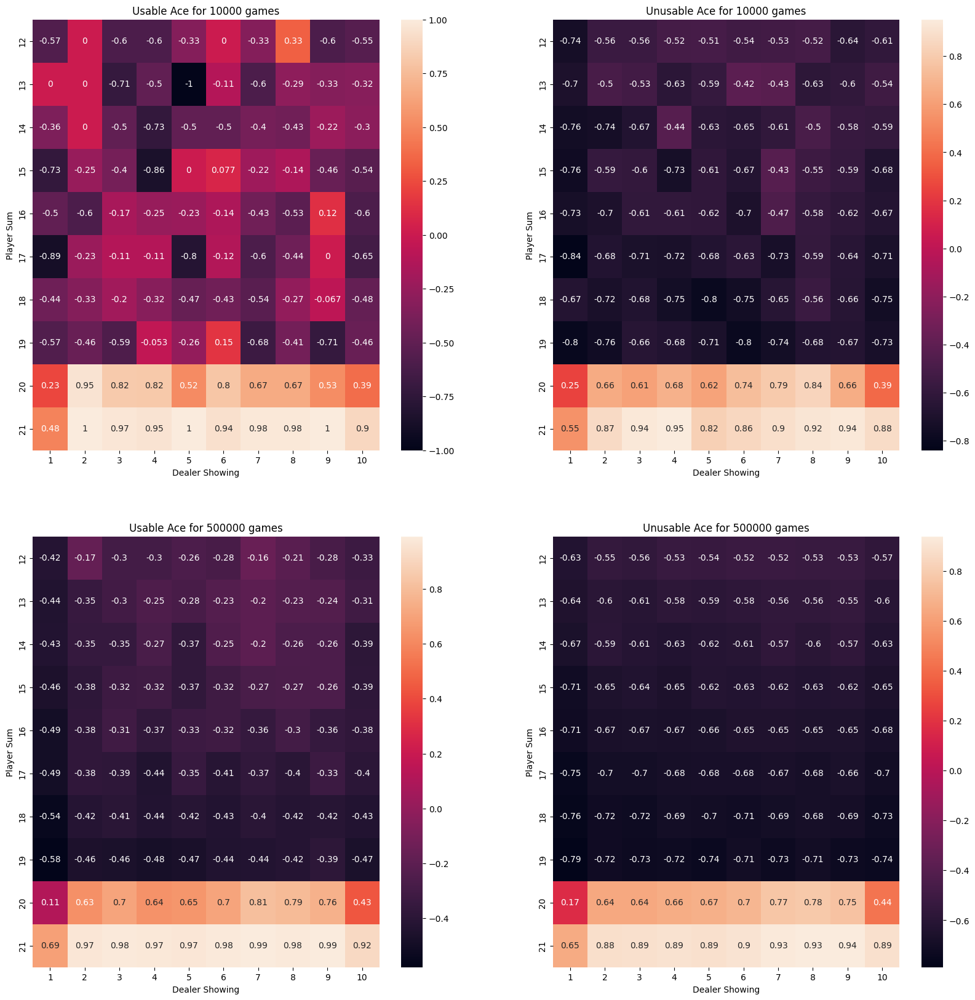

In [16]:
# plot 4 heatmaps for 4 different value functions, each heatmap has 10 rows and 10 columns. The x axis is the player's sum (from 12 to 21), 
#the y axis is the dealer's showing card(from 1 to 10). The color represents the value of the state.
# plot the value function for usable ace with 10 as the dealer's showing card
# plot 4 subplots in one figure, increase the size of the figure
fig, ax = plt.subplots(2, 2, figsize=(20, 20))
usable_ten = np.zeros((10, 10))
for i in range(12,22):
    for j in range(1,11):
        usable_ten[i-12, j-1] = values_usable_ten[(i,j,True)]
sns.heatmap(usable_ten, xticklabels=np.arange(1, 11), yticklabels=np.arange(12, 22), annot=True, ax=ax[0, 0])
ax[0, 0].set_title('Usable Ace for 10000 games')
ax[0, 0].set_ylabel('Player Sum')
ax[0, 0].set_xlabel('Dealer Showing')
unusable_ten = np.zeros((10, 10))
for i in range(12,22):
    for j in range(1,11):
        unusable_ten[i-12, j-1] = values_unusable_ten[(i,j,False)]
sns.heatmap(unusable_ten, xticklabels=np.arange(1, 11), yticklabels=np.arange(12, 22), annot=True, ax=ax[0, 1])
ax[0, 1].set_title('Unusable Ace for 10000 games')
ax[0, 1].set_ylabel('Player Sum')
ax[0, 1].set_xlabel('Dealer Showing')
usable_five = np.zeros((10, 10))
for i in range(12,22):
    for j in range(1,11):
        usable_five[i-12, j-1] = values_usable_five[(i,j,True)]
sns.heatmap(usable_five, xticklabels=np.arange(1, 11), yticklabels=np.arange(12, 22), annot=True, ax=ax[1, 0])
ax[1, 0].set_title('Usable Ace for 500000 games')
ax[1, 0].set_ylabel('Player Sum')
ax[1, 0].set_xlabel('Dealer Showing')
unusable_five = np.zeros((10, 10))
for i in range(12,22):
    for j in range(1,11):
        unusable_five[i-12, j-1] = values_unusable_five[(i,j,False)]
sns.heatmap(unusable_five, xticklabels=np.arange(1, 11), yticklabels=np.arange(12, 22), annot=True, ax=ax[1, 1])
ax[1, 1].set_title('Unusable Ace for 500000 games')
ax[1, 1].set_ylabel('Player Sum')
ax[1, 1].set_xlabel('Dealer Showing')
plt.show()




## Q7

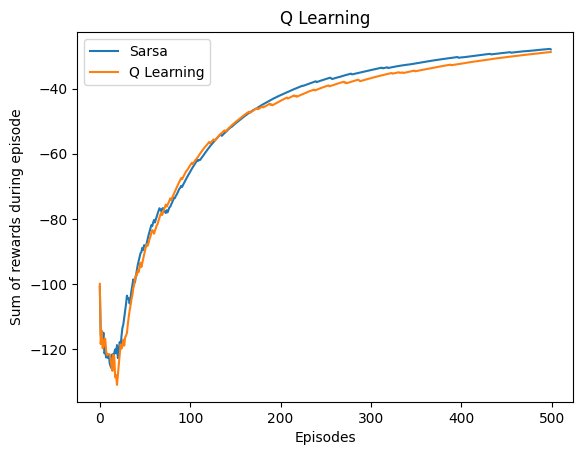

In [42]:
def isValid(x, y):
    if x >= 0 and x < grid_width and y >= 0 and y < grid_height:
        return True
    else:
        return False

GAMMA = 1 # undiscounted task
EPSILON = 0.1
ALPHA = 0.5
grid_height = 4
grid_width = 12
# 0 is left, 1 is right, 2 is up, 3 is down
ACTIONS = [0, 1, 2, 3]
start_pos = (0, 0) # starting position(bottom left corner)
goal_pos = (11, 0) # terminal state

def step(s, a):
    x, y = s
    if a == 0:
        if isValid(x-1, y):
            x = x-1
    elif a == 1:
        if isValid(x+1, y):
            x = x+1
    elif a == 2:
        if isValid(x, y+1):
            y = y+1
    elif a == 3:
        if isValid(x, y-1):
            y = y-1
    next_s = (x, y)
    reward = -1
    # if on cliff, go back to start and get -100 reward
    if (a == 3 and y == 1 and 1 <= x <= 10) or (a == 1 and s == start_pos):
        next_s = start_pos
        reward = -100
    return next_s, reward

def pick_action(s, q_vals):
    if np.random.binomial(1, EPSILON) == 1: # explore
        return np.random.choice(ACTIONS)
    else: # exploit
        vals = q_vals[s[0], s[1], :]
        return np.random.choice([action for action, val in enumerate(vals) if val == np.max(vals)])
    
def sarsa(q_vals):
    episodes = 500
    reward_per_episode = []
    mean_reward_till_now = []
    for _ in range(episodes):
        s = start_pos
        a = pick_action(s, q_vals)
        reward_sum = 0
        while s != goal_pos: # while not terminal state
            next_s, reward = step(s, a)
            next_a = pick_action(next_s, q_vals)
            reward_sum += reward
            q_vals[s[0], s[1], a] += ALPHA * (reward + GAMMA*q_vals[next_s[0], next_s[1], next_a] - q_vals[s[0], s[1], a])
            s = next_s
            a = next_a
            if reward == -100:
                break
        reward_per_episode.append(reward_sum)
        mean_reward_till_now.append(np.mean(reward_per_episode))
    return mean_reward_till_now

def q_learning(q_vals):
    episodes = 500
    reward_per_episode = []
    mean_reward_till_now = []
    for eps in range(episodes):
        reward_sum = 0
        s = start_pos
        while s != goal_pos:
            a = pick_action(s, q_vals)
            next_s, reward = step(s, a)
            reward_sum += reward
            q_vals[s[0], s[1], a] += ALPHA * (reward + GAMMA*np.max(q_vals[next_s[0], next_s[1], :]) - q_vals[s[0], s[1], a])
            s = next_s
            if reward == -100:
                break
        reward_per_episode.append(reward_sum)
        mean_reward_till_now.append(np.mean(reward_per_episode))
    return mean_reward_till_now

q_vals1 = np.zeros((grid_width, grid_height, len(ACTIONS)))
q_vals2 = np.zeros((grid_width, grid_height, len(ACTIONS)))
q_learn_rewards = q_learning(q_vals1)
sarsa_rewards = sarsa(q_vals2)
# plot q_learn_rewards and sarsa_rewards in same figure
plt.plot(sarsa_rewards)
plt.plot(q_learn_rewards)
plt.legend(['Sarsa', 'Q Learning'])
plt.title('Q Learning')
plt.xlabel('Episodes')
plt.ylabel('Sum of rewards during episode')
plt.show()







    




